In [1]:
library(rstan)
# sessionInfo()

# https://github.com/stan-dev/rstan/wiki/RStan-Getting-Started-(Japanese)
#　このページに書いてあるRstanの例をやってみた
#web上からモデルを直接とってきたよ

Loading required package: ggplot2
Loading required package: StanHeaders
rstan (Version 2.10.1, packaged: 2016-06-24 13:22:16 UTC, GitRev: 85f7a56811da)
For execution on a local, multicore CPU with excess RAM we recommend calling
rstan_options(auto_write = TRUE)
options(mc.cores = parallel::detectCores())


In [2]:
# stanフィアルをmodelにいれとく
require("RCurl")
model <- getURL("https://raw.githubusercontent.com/wiki/stan-dev/rstan/8schools.stan")

cat(model)


Loading required package: RCurl
Loading required package: bitops


data {
  int<lower=0> J; // number of schools 
  real y[J]; // estimated treatment effects
  real<lower=0> sigma[J]; // s.e. of effect estimates 
}
parameters {
  real mu; 
  real<lower=0> tau;
  real eta[J];
}
transformed parameters {
  real theta[J];
  for (j in 1:J)
    theta[j] <- mu + tau * eta[j];
}
model {
  eta ~ normal(0, 1);
  y ~ normal(theta, sigma);
}


In [3]:
schools_dat <- list(J = 8,
                    y = c(28,  8, -3,  7, -1,  1, 18, 12),
                    sigma = c(15, 10, 16, 11,  9, 11, 10, 18))

fit <- stan(model_code = model, data = schools_dat,
            iter = 1000, chains = 4)


SAMPLING FOR MODEL '11c3f2ab2915ebbd699e7fb4bf5bd2dc' NOW (CHAIN 1).

Chain 1, Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 1, Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 1, Iteration: 200 / 1000 [ 20%]  (Warmup)
Chain 1, Iteration: 300 / 1000 [ 30%]  (Warmup)
Chain 1, Iteration: 400 / 1000 [ 40%]  (Warmup)
Chain 1, Iteration: 500 / 1000 [ 50%]  (Warmup)
Chain 1, Iteration: 501 / 1000 [ 50%]  (Sampling)
Chain 1, Iteration: 600 / 1000 [ 60%]  (Sampling)
Chain 1, Iteration: 700 / 1000 [ 70%]  (Sampling)
Chain 1, Iteration: 800 / 1000 [ 80%]  (Sampling)
Chain 1, Iteration: 900 / 1000 [ 90%]  (Sampling)
Chain 1, Iteration: 1000 / 1000 [100%]  (Sampling)
 Elapsed Time: 0.020602 seconds (Warm-up)
               0.024495 seconds (Sampling)
               0.045097 seconds (Total)


SAMPLING FOR MODEL '11c3f2ab2915ebbd699e7fb4bf5bd2dc' NOW (CHAIN 2).

Chain 2, Iteration:   1 / 1000 [  0%]  (Warmup)
Chain 2, Iteration: 100 / 1000 [ 10%]  (Warmup)
Chain 2, Iteration: 200 / 1000 [ 20%]  (Warmup)

Inference for Stan model: 11c3f2ab2915ebbd699e7fb4bf5bd2dc.
4 chains, each with iter=1000; warmup=500; thin=1; 
post-warmup draws per chain=500, total post-warmup draws=2000.

          mean se_mean   sd   2.5%   25%   50%   75% 97.5% n_eff Rhat
mu        7.97    0.13 4.59  -0.87  4.75  7.93 10.91 16.98  1228    1
tau       5.87    0.20 5.19   0.14  2.02  4.64  8.18 18.70   693    1
eta[1]    0.39    0.02 0.97  -1.52 -0.25  0.40  1.05  2.26  1654    1
eta[2]   -0.02    0.02 0.91  -1.76 -0.63 -0.03  0.59  1.71  1808    1
eta[3]   -0.19    0.02 0.93  -2.01 -0.83 -0.20  0.45  1.60  1471    1
eta[4]   -0.04    0.02 0.83  -1.66 -0.60 -0.05  0.49  1.66  1399    1
eta[5]   -0.33    0.02 0.91  -2.10 -0.92 -0.35  0.25  1.58  1516    1
eta[6]   -0.18    0.02 0.89  -1.94 -0.75 -0.21  0.41  1.63  1833    1
eta[7]    0.38    0.02 0.86  -1.33 -0.17  0.38  0.93  2.05  1554    1
eta[8]    0.09    0.02 0.93  -1.85 -0.48  0.05  0.66  2.00  1677    1
theta[1] 11.06    0.22 8.13  -2.20  5.85 10.10 15.03 3

'pars' not specified. Showing first 10 parameters by default.
ci_level: 0.8 (80% intervals)
outer_level: 0.95 (95% intervals)


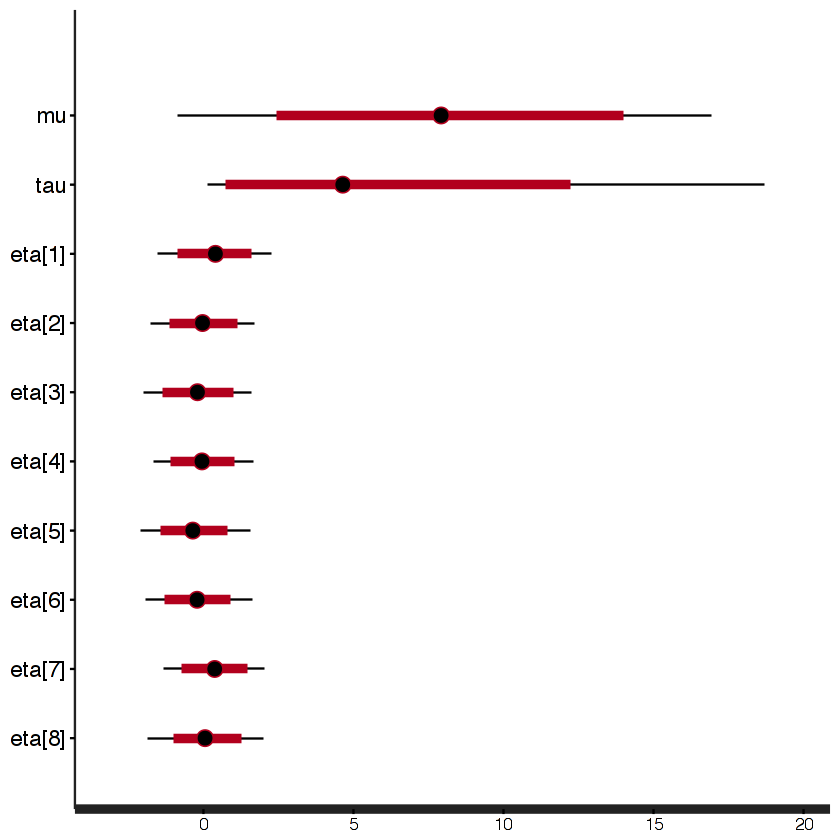

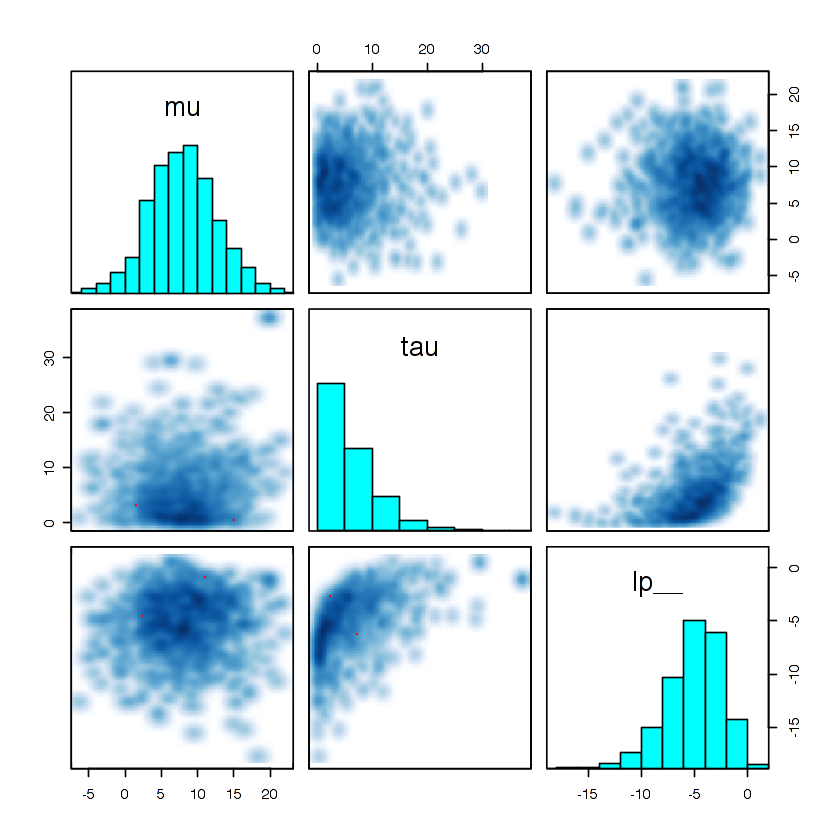

In [4]:
print(fit)
plot(fit)
pairs(fit, pars = c("mu", "tau", "lp__"))

la <- extract(fit, permuted = TRUE) # arraysのlistを返す
mu <- la$mu

### iterations, chains, parametersの3次元arrayを返す
a <- extract(fit, permuted = FALSE)

### stanfitオブジェクトにS3関数のas.array（やas.matrix）を使う
a2 <- as.array(fit)
m <- as.matrix(fit)

'pars' not specified. Showing first 10 parameters by default.


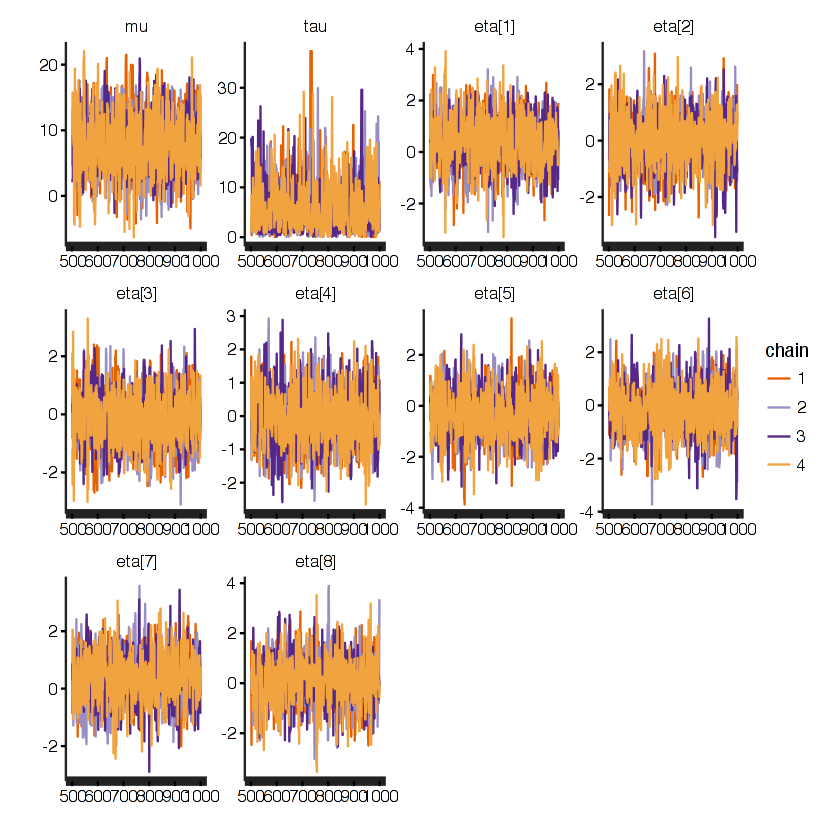

In [5]:
traceplot(fit )